In [1]:
import cudf
import cupy as cp
import cuml
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pickle
import plotly.express as px
import plotly.graph_objects as go
import scipy as scp
import scipy.cluster.hierarchy as hcluster
#import pyrolite.comp
import seaborn as sns

from cuml import RandomForestRegressor as cuRF
from cuml.cluster import HDBSCAN
from mpl_toolkits.mplot3d import axes3d
from sklearn.preprocessing import StandardScaler
from tqdm.notebook import tqdm
from variables import col_names, col_dtype, major_element_names, trace_element_names, major_element_labels, trace_element_labels, trace_element_dict, major_element_dict

In [2]:
data = np.genfromtxt("NURE_RTX_RankAssay_NUM.txt", dtype=col_dtype, names = col_names, delimiter=",", skip_header=1)
df = pd.DataFrame(data)
df = df[(df["SAMPLETYPE"] == "\"StreamSed\"")] # Only use the stream-sed samples.

In [3]:
def heatmap(dataframe, labels):
    corr = dataframe.corr() # Compute the correlation matrix 
    umask = np.triu(np.ones_like(corr, dtype=bool)) # Generate a mask for the upper triangle
    f, ax = plt.subplots(figsize=(12, 9)) # Set up the matplotlib figure
    cmap = sns.diverging_palette(220, 10, as_cmap=True) # Generate a custom diverging colormap
    sns.heatmap(corr, mask=umask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, ax=ax,
            xticklabels=labels, yticklabels=labels
               ) # Draw the heatmap with the mask and correct aspect ratio

In [4]:
def pairplots(dataframe, labels):
    g = sns.PairGrid(dataframe.sample(frac = 0.1))
    g = g.map_upper(sns.scatterplot, alpha = 0.1)
    g = g.map_diag(sns.kdeplot)
    g = g.map_lower(sns.kdeplot)
    plt.show()

In [5]:
def buttons_dict(element_names, element_dict, dataframe, x_anchor, y_anchor, dim_type, button_type):
    
    update_menus = []
    if button_type == "density":
        for element in element_names:
            update_dict = {}
            update_dict['args'] = [{dim_type:[dataframe[element]]}]
            update_dict['name'] = element_dict.get(element)
            update_dict['label'] = element_dict.get(element)
            update_dict['method'] = 'update'
            update_menus.append(update_dict)
    
    if button_type == "scatter":
        for element in element_names:
            update_dict = {}
            update_dict['args'] = [{"color":[dataframe[element]]}]
            update_dict['name'] = element_dict.get(element)
            update_dict['label'] = element_dict.get(element)
            update_dict['method'] = 'relayout'
            update_menus.append(update_dict)

    if dim_type == 'y':
        direction = 'right'
    elif dim_type == 'z':
        direction = 'down'
    elif dim_type == 'x':
        direction = "up"
    else:
        direction = "down"
    
    button = [{'buttons':update_menus,
             'direction':direction,
            'showactive':True,
            'x':x_anchor,
            'y':y_anchor
              }]
    return button

In [6]:
def create_plotly(element_names, element_dict, dataframe, center, x_anchor, y_anchor, dim_type):
    fig = go.Figure()

    buttons = buttons_dict(element_names, element_dict, dataframe, x_anchor, y_anchor, dim_type, "density")

    # Add surface trace
    fig = px.density_mapbox(data_frame = dataframe,
                            lat = dataframe["WGS84_WORLD_LL_Calc_Y"].astype(float), 
                            lon = dataframe["WGS84_WORLD_LL_Calc_X" ].astype(float), 
                            z = element_names[0],
                            radius=5,
                            center=dict(lat=center[0], lon=center[1]), 
                            zoom=7,
                            mapbox_style="stamen-terrain")
    steps = []
    for i in range(10):
        step = dict(
            method="update",
            args=[{"radius": 1+i*3}]
        )
        steps.append(step)

    sliders = [dict(
        active=10,
        currentvalue={"prefix": "Radius: "},
        pad={"t": 10},
        steps=steps
    )]

    # Update plot sizing
    fig.update_layout(
        width=800,
        height=900,
        autosize=False,
        margin=dict(t=0, b=0, l=0, r=0),
        template="plotly_white",
    )

    # Update 3D scene options
    fig.update_scenes(
        aspectratio=dict(x=1, y=1, z=0.7),
        aspectmode="manual"
    )

    # Add dropdown
    fig.update_layout(
        updatemenus=buttons,
        sliders=sliders
    )


    fig.show()

In [7]:
def create_plotly_mapbox(element_names, element_dict, dataframe, center, x_anchor, y_anchor, dim_type):
    fig = go.Figure()

    buttons = buttons_dict(element_names, element_dict, dataframe, x_anchor, y_anchor, dim_type, "scatter")
    
    # Add surface trace
    fig = px.scatter_mapbox(data_frame = dataframe,
                            lat = "WGS84_WORLD_LL_Calc_Y", 
                            lon = "WGS84_WORLD_LL_Calc_X", 
                            color = element_names[dim_type],
                            size = element_names[dim_type],
                            center=dict(lat=center[0], lon=center[1]), 
                            zoom=7,
                            mapbox_style="stamen-terrain"
                         )
        
    # Update plot sizing
    fig.update_layout(
        width=800,
        height=900,
        margin=dict(t=0, b=0, l=0, r=0),
        template="plotly_white",
        updatemenus=buttons
    )

    fig.show()

## Simple EDA on major elements

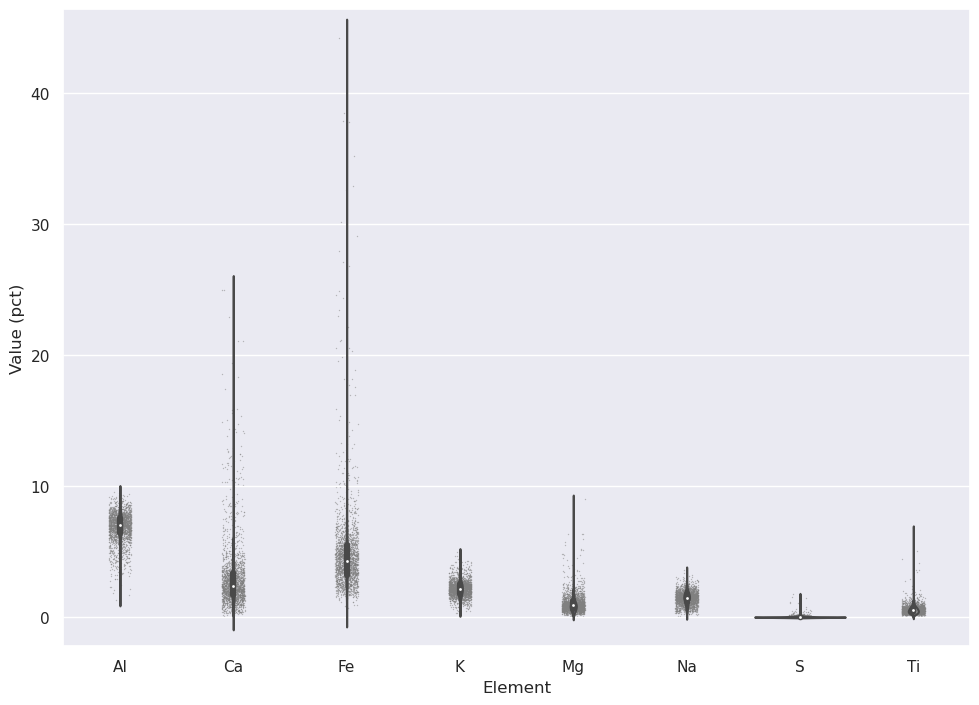

In [8]:
#| fig-cap: 
#|   - "Violin plot of major elements with jitter values."

sns.set(rc={'figure.figsize':(11.7,8.27)})
major_data_melt = pd.melt(df[major_element_names], ignore_index=True)
major_data_melt.replace({"variable": major_element_dict}, inplace=True)

sns.violinplot(data=major_data_melt, x="variable", y="value")
sns.stripplot(data=major_data_melt,  x="variable", y="value", alpha = 0.5, zorder=0, size = 1, color = 'grey')

plt.xlabel('Element')
plt.ylabel('Value (pct)')
plt.show()

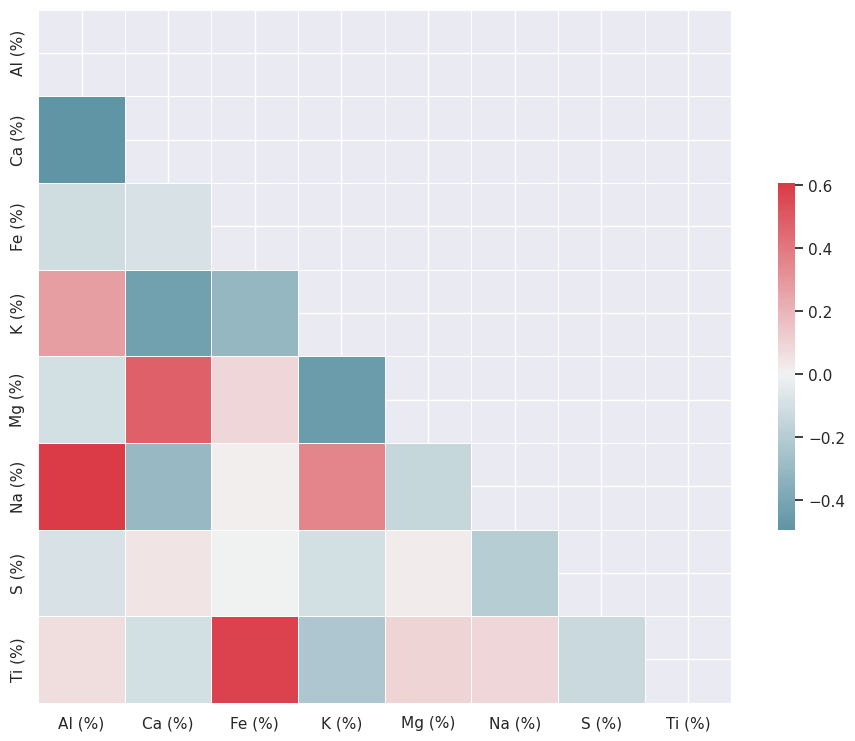

In [9]:
#| fig-cap: 
#|   - "Major element correlation plot."
heatmap(df[major_element_names], major_element_labels)

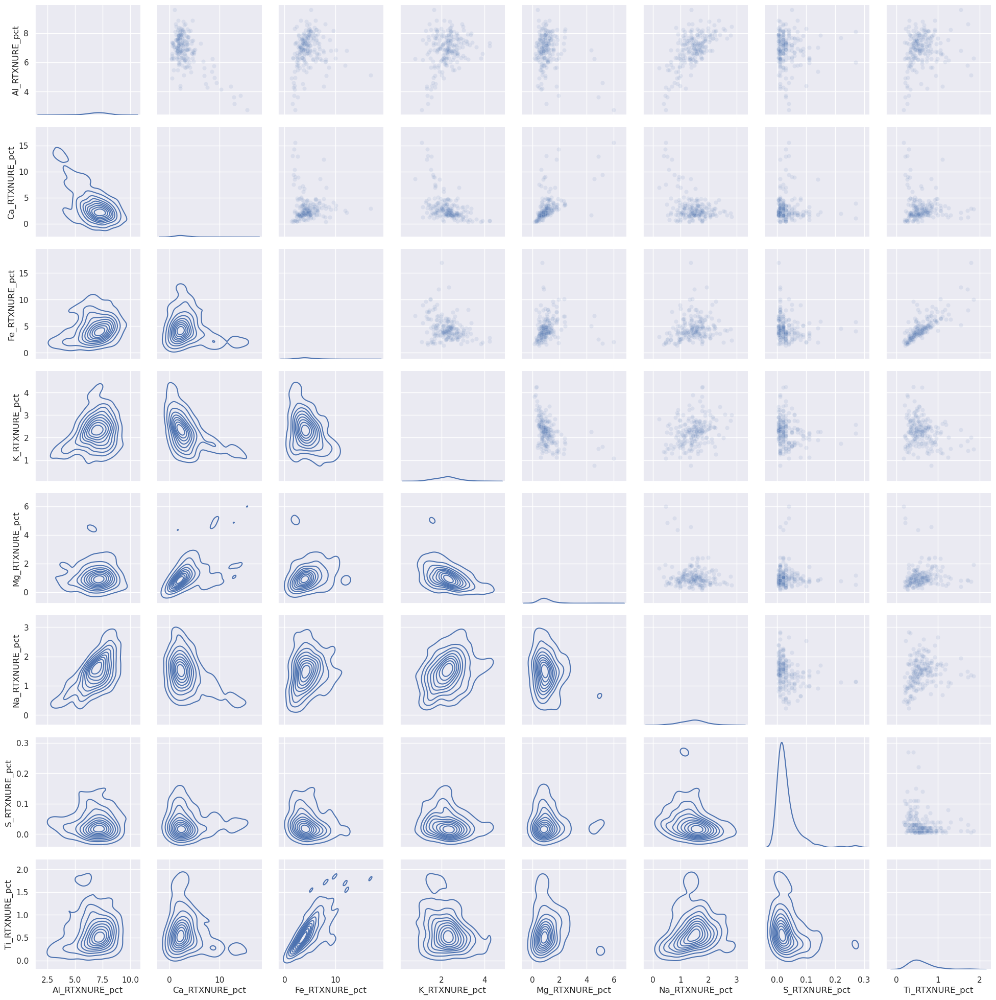

In [10]:
#| fig-cap: 
#|   - "Pairplot of all major elements with KDE plot along axis."
pairplots(df[major_element_names], major_element_labels)

## Simple EDA on Trace Elements

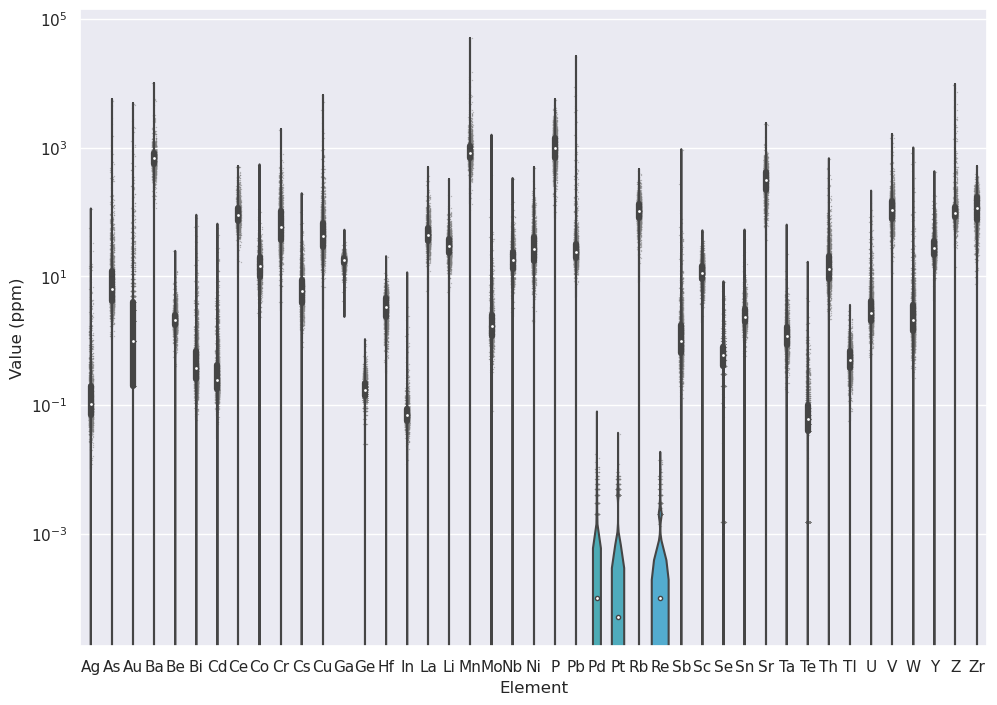

In [11]:
#| fig-cap: 
#|   - "Violin plot of trace elements with jitter values."
sns.set(rc={'figure.figsize':(11.7,8.27)})
trace_data_melt = pd.melt(df[trace_element_names], ignore_index=True)
trace_data_melt.replace({"variable": trace_element_dict}, inplace=True)
sns.violinplot(data=trace_data_melt, x="variable", y="value")
sns.stripplot(data=trace_data_melt,  x="variable", y="value", alpha = 0.5, zorder=0, size = 1, color = 'grey')
plt.yscale('log')
plt.xlabel('Element')
plt.ylabel('Value (ppm)')
plt.show()

The correlation plot of all trace elements below is skewed towards positive correlations, with several elements such as Hf and Zr being strong correlated. As such, dimension reduction through PCA is suggested prior to the random forest predictions. 

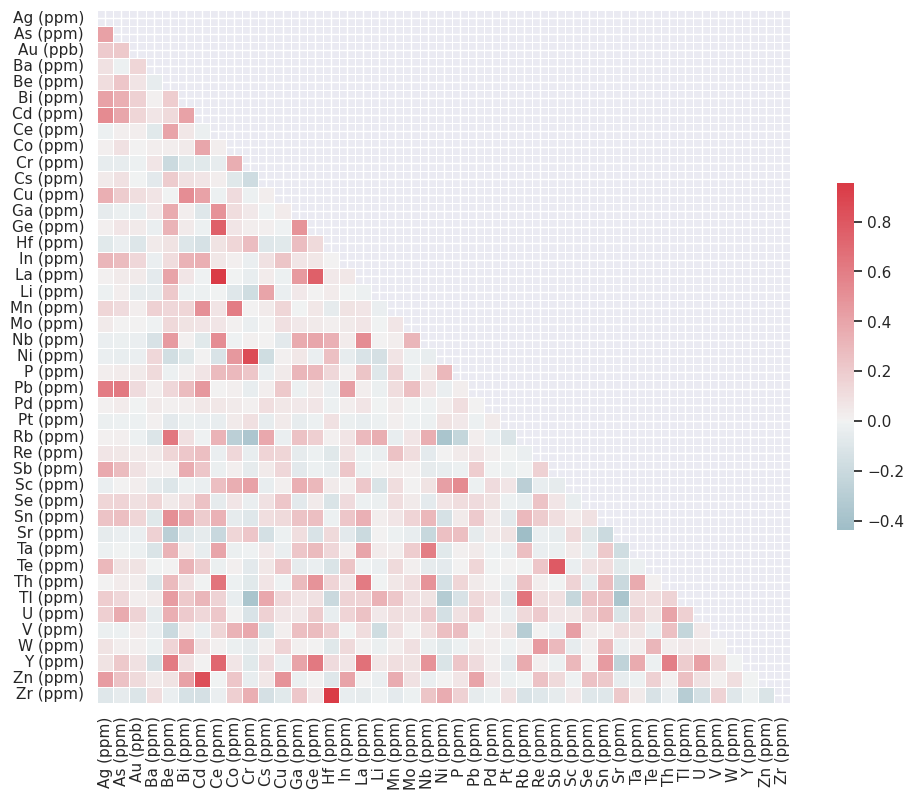

In [12]:
#| fig-cap: 
#|   - "Trace element correlation plot."
heatmap(df[trace_element_names], trace_element_labels)

The dendogram below provides another representation of how similar/disimilar each element is from each other. 

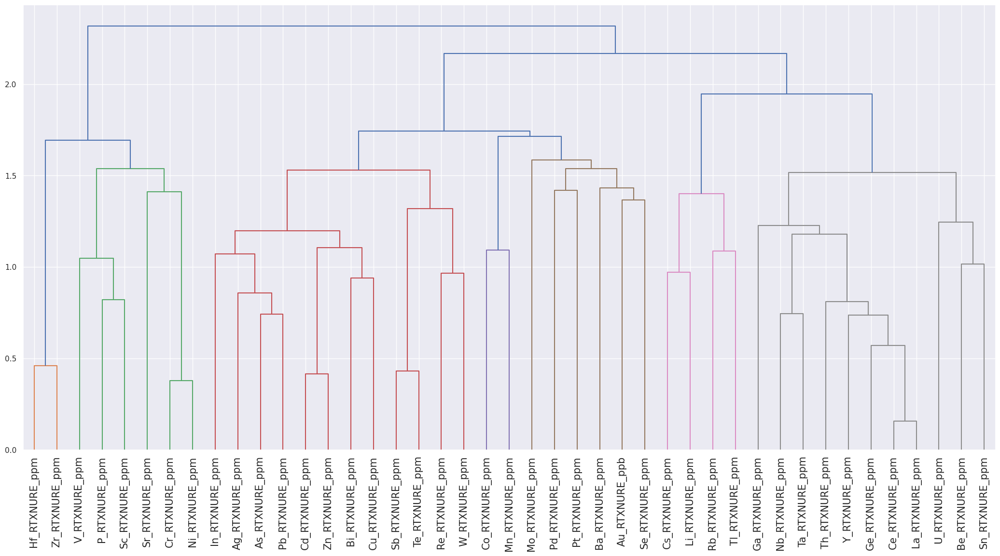

In [13]:
#| fig-cap: 
#|   - "Dendrogram showing relative similarity of trace elements."
plt.rcParams["figure.figsize"] = (26,12)
ax = plt.gca()
trace_element_corr = df[trace_element_names].corr()
z = hcluster.linkage(trace_element_corr.values, method='average')
dendrogram = hcluster.dendrogram(z, labels=trace_element_names, ax=ax)
ax.tick_params(axis='x', which='major', labelsize=15)
plt.show()

In [14]:
#| fig-cap: 
#|   - "2D scatterplots of trace element data (log/log axes)."

element_names = trace_element_names
element_dict = trace_element_dict

dataframe = df[trace_element_names]

fig = go.Figure()

buttons1 = buttons_dict(element_names, element_dict, dataframe, 0.5, -0.05, 'x')
buttons2 = buttons_dict(element_names, element_dict, dataframe, -0.05, 0.5, 'y')

# Add surface trace
fig = px.scatter(dataframe, x="Ag_RTXNURE_ppm", y="As_RTXNURE_ppm", log_x = True, log_y = True)

# Add dropdown
fig.update_layout(
    width=800,
    height=900,
    autosize=False,
    template="plotly_white",
    updatemenus=[buttons1[0], buttons2[0]] 
)

fig.update_layout(xaxis_title=None, yaxis_title=None)

fig.show()

TypeError: buttons_dict() missing 1 required positional argument: 'button_type'

In [15]:
filtered_df = df[(df["WGS84_WORLD_LL_Calc_X"].between(-111.447, -108.9730)) & (df["WGS84_WORLD_LL_Calc_Y"] <= 34.15765)].dropna()
dist_matrix = scp.spatial.distance.squareform(scp.spatial.distance.pdist(filtered_df[["WGS84_WORLD_LL_Calc_X","WGS84_WORLD_LL_Calc_Y"]].values, 'seuclidean', V=None))
cp_dist_matrix = cp.asarray(dist_matrix, dtype = cp.float32)

In [16]:
scale= StandardScaler()
scaled_data = pd.DataFrame(scale.fit_transform(filtered_df[major_element_names+  trace_element_names]), columns = trace_element_names + major_element_names)

In [17]:
scaled_df = pd.concat([scaled_data, filtered_df[["WGS84_WORLD_LL_Calc_X","WGS84_WORLD_LL_Calc_Y"]].reset_index()], ignore_index=True, axis = 1)
cu_filtered_df = cudf.DataFrame(scaled_df).dropna()
cu_raw_filtered_df = cudf.DataFrame(filtered_df[major_element_names+trace_element_names + ["WGS84_WORLD_LL_Calc_X","WGS84_WORLD_LL_Calc_Y"]].dropna())
cp_raw_filtered = cp.asarray(cu_raw_filtered_df.iloc[:,:-2].values, dtype=cp.float32)
cp_filtered = cp.asarray(cu_filtered_df.iloc[:,:-2].values, dtype=cp.float32)
cov_mat = np.cov(cp_filtered[:,:-2].T)
eigen_vals, eigen_vecs = np.linalg.eigh(cov_mat)

sorted_index = np.argsort(eigen_vals)[::-1]
sorted_eigenvalue = eigen_vals[sorted_index]
sorted_eigenvectors = eigen_vecs[:,sorted_index]

In order to determine the optimal number of principal components to retain, their individual contributions to variance is plotted. As in the diagram below, reducing the dataset to only 5 PCAs keep >99% of the data's variance while reducing the dimensionality by an order of magnitude.

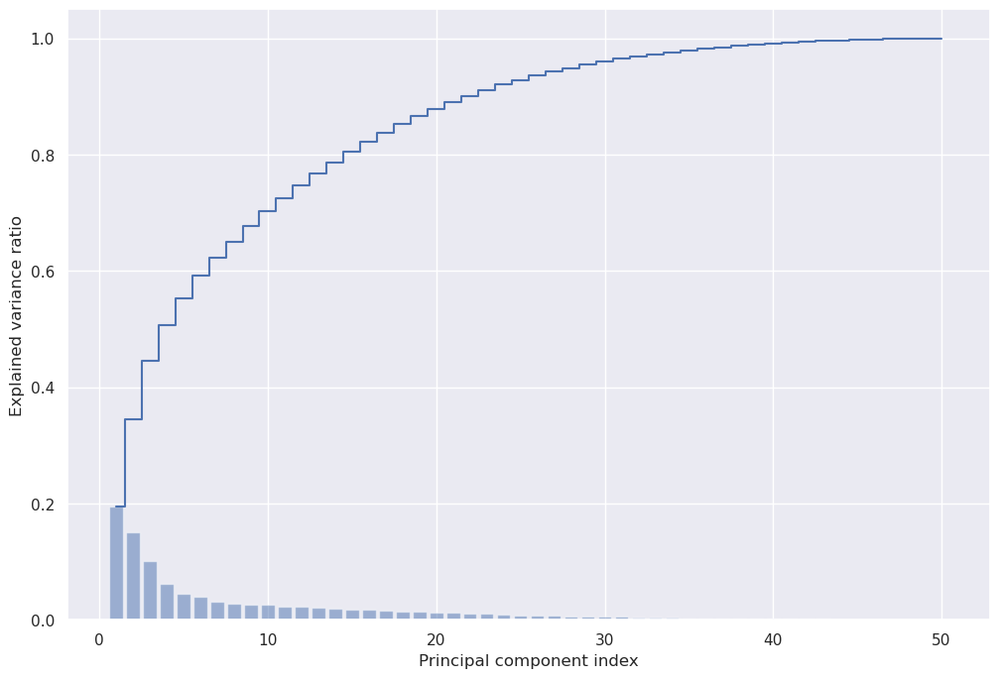

In [18]:
#| fig-cap: 
#|   - "Explained variance of principle components."

plt.rcParams["figure.figsize"] = (12,8)
# Calculate cumulative sum of explained variances
tot = sum(cp.asnumpy(eigen_vals))
var_exp = [(i / tot) for i in sorted(cp.asnumpy(eigen_vals), reverse=True)]
cum_var_exp = np.cumsum(var_exp)

# Plot explained variances
plt.bar(range(1,51), var_exp, alpha=0.5,align='center')
plt.step(range(1,51), cum_var_exp, where='mid')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.show()

In [19]:
# Select the first n eigenvectors, n is desired dimension of our final reduced data.
n_components = 30 #you can select any number of components.
eigenvector_subset = sorted_eigenvectors[:,0:n_components]
#Transform the data 
X_reduced = np.dot(eigenvector_subset.transpose(),cp_filtered[:,:-2].T).T
cp_filtered_PCA = cp.concatenate((cp_raw_filtered, X_reduced), axis = 1)
center = (32.9, -110.3)

In order to reduce the number of samples to a more practicable level, the data will be filtered by x/y coordinates to focus on the tight cluster of data in the SE. 

In [20]:
#| fig-cap: 
#|   - "Geopgraphic plot of major element distributions."
create_plotly(major_element_names, major_element_dict, df, center, 0.1, 1.0, 'z')

In [21]:
#| fig-cap: 
#|   - "Geopgraphic plot of trace element distributions."
create_plotly(trace_element_names, trace_element_dict, df, center, 0.1, 1.0, 'z')

In [23]:
cu_rf_params = {
     'n_estimators': 100,
     'max_depth': 16,
     'max_batch_size': 512,
     'max_features':'sqrt',
     'min_samples_split':10,
     'n_streams': 4,
     'n_bins':64,
     'split_criterion': 'poisson',
     'bootstrap': False,
     'accuracy_metric':'r2',
     'output_type':'cupy'
 }

total = len(major_element_names+trace_element_names)

all_predictions = []
for i in tqdm(range(len(cp_filtered_PCA)), desc = 'Random Forest Progress:'):
    distance_filter = dist_matrix[i,:] >= 0.1
    cp_df = cp_filtered_PCA[distance_filter]
    predictions = []
    for j in range(total):
        X_train = cp_df[:,-30:]
        y_train = cp_df[:,j]
        cu_rf = cuRF(**cu_rf_params)
        cu_rf.fit(X_train, y_train)
        answer = cp.array(cp_filtered_PCA[i,-30:].reshape(1,-1), dtype = 'float32')
        prediction = cu_rf.predict(answer, predict_model='GPU', algo='naive', fil_sparse_format = True, convert_dtype = False)
        predictions.append(prediction[0])
        #break
    all_predictions.append(predictions)
    #break

pickle_df = pd.DataFrame(all_predictions, columns = (major_element_names+trace_element_names))
pickle_df["WGS84_WORLD_LL_Calc_Y"] = filtered_df["WGS84_WORLD_LL_Calc_Y"].values
pickle_df["WGS84_WORLD_LL_Calc_X"] = filtered_df["WGS84_WORLD_LL_Calc_X"].values
pickle_df.to_pickle("./random_forest.pkl")

Random Forest Progress::   0%|          | 0/1292 [00:00<?, ?it/s]

/home/ykinakin/miniconda3/envs/rapids-23.04/lib/python3.8/site-packages/cuml/internals/api_decorators.py:188: UserWarning:

To use pickling first train using float32 data to fit the estimator



In [24]:
pickle_df = pd.DataFrame(all_predictions, columns = (major_element_names+trace_element_names))
pickle_df["WGS84_WORLD_LL_Calc_Y"] = filtered_df["WGS84_WORLD_LL_Calc_Y"].values
pickle_df["WGS84_WORLD_LL_Calc_X"] = filtered_df["WGS84_WORLD_LL_Calc_X"].values
pickle_df.to_pickle("./random_forest_1.pkl")

In [36]:
unpickled_df = pd.read_pickle("./random_forest.pkl")
predicted_values = pd.DataFrame(unpickled_df.values, columns = (major_element_names+trace_element_names + ["WGS84_WORLD_LL_Calc_Y","WGS84_WORLD_LL_Calc_X"]), dtype = 'float32')
labels_df = filtered_df[major_element_names+trace_element_names + ["WGS84_WORLD_LL_Calc_Y","WGS84_WORLD_LL_Calc_X"]].reset_index(drop = True)

In [37]:
percentage_diff = (1/2)*abs(predicted_values.iloc[:,:-2] - labels_df.iloc[:,:-2])/(predicted_values.iloc[:,:-2] + labels_df.iloc[:,:-2]) * 100
percentage_diff[["WGS84_WORLD_LL_Calc_Y","WGS84_WORLD_LL_Calc_X"]] = predicted_values.iloc[:,-2:]

For each datapoint, a prediction of each elemental value is made by a random forest trained on all datapoints greater than 11km away. The figure below plots the absolute precentage difference between the model predictions and the true data values. High values indicate regions where the data values tend not to have the same variance as the remaining data. 

In [38]:
percentage_diff

,Al_RTXNURE_pct,Ca_RTXNURE_pct,Fe_RTXNURE_pct,K_RTXNURE_pct,Mg_RTXNURE_pct,Na_RTXNURE_pct,S_RTXNURE_pct,Ti_RTXNURE_pct,Ag_RTXNURE_ppm,As_RTXNURE_ppm,...,Th_RTXNURE_ppm,Tl_RTXNURE_ppm,U_RTXNURE_ppm,V_RTXNURE_ppm,W_RTXNURE_ppm,Y_RTXNURE_ppm,Zn_RTXNURE_ppm,Zr_RTXNURE_ppm,WGS84_WORLD_LL_Calc_Y,WGS84_WORLD_LL_Calc_X
0,0.969568,13.061831,2.682028,1.697155,4.898222,4.473299,28.266569,8.572776,18.872921,7.096349,...,4.163118,0.821411,6.477412,1.783733,13.664394,1.322583,0.728178,1.609769,31.499601,-109.048492
1,4.732521,2.884856,2.366695,1.656279,5.640642,17.362803,8.263494,6.674494,0.071588,12.420848,...,10.743958,5.735131,3.430008,9.947889,12.515343,5.692023,10.374249,3.191885,33.095394,-110.870850
2,6.716250,2.145615,3.114181,1.818506,5.458547,23.056486,11.786631,7.189839,4.658387,5.623980,...,12.204007,5.458821,7.869888,16.521681,18.495884,6.123429,12.662262,5.776922,33.099747,-110.866867
3,11.268405,18.766808,4.406848,1.925353,9.160339,22.018583,33.533813,2.981718,10.430416,4.705973,...,18.803654,4.173426,8.203134,5.378652,25.785633,5.651775,0.516273,3.440960,33.078457,-110.878090
4,0.386381,1.216190,1.370440,4.969766,8.491757,9.062380,31.368721,5.719675,17.175709,0.930939,...,18.850725,9.421384,18.182053,12.262125,17.559105,9.071932,7.507394,5.096257,33.111523,-110.905457
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1287,0.748151,8.585277,6.765717,1.055862,9.612567,2.697521,11.627169,6.064222,2.016128,11.071696,...,5.418754,3.905915,1.150755,7.912335,7.848696,0.268893,7.047606,4.854456,31.908419,-109.081039
1288,0.111714,12.997476,4.451606,4.060987,8.306253,1.152408,25.354342,6.038460,14.898939,2.784343,...,8.612098,0.226070,4.165624,6.640163,15.435794,6.570399,0.168641,2.422969,31.895725,-109.118958
1289,0.878456,22.627773,8.958567,4.905971,18.089577,0.662006,8.300023,4.210945,6.693958,3.531672,...,3.872159,4.861148,3.119223,12.829426,15.678537,0.383215,1.411686,1.977023,31.888657,-109.107666
1290,0.592155,3.270146,1.509579,1.500978,7.403591,0.164206,17.523653,0.213275,1.878352,3.037651,...,6.469786,2.657665,1.443954,2.952609,13.902376,1.632855,0.081038,1.832519,31.932510,-109.112244


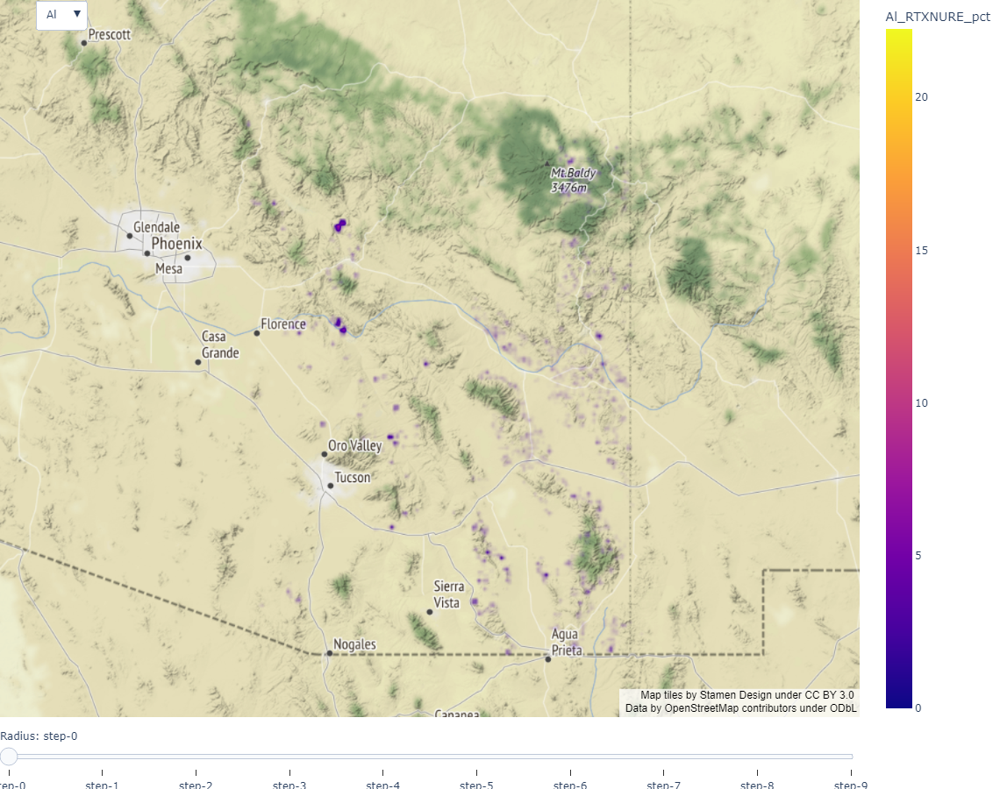

In [39]:
#| fig-cap: 
#|   - "Geopgraphic plot of absolute difference between major element values and predictions from random forest."
create_plotly(major_element_names, major_element_dict, percentage_diff, center, 0.1, 1.0, "z")

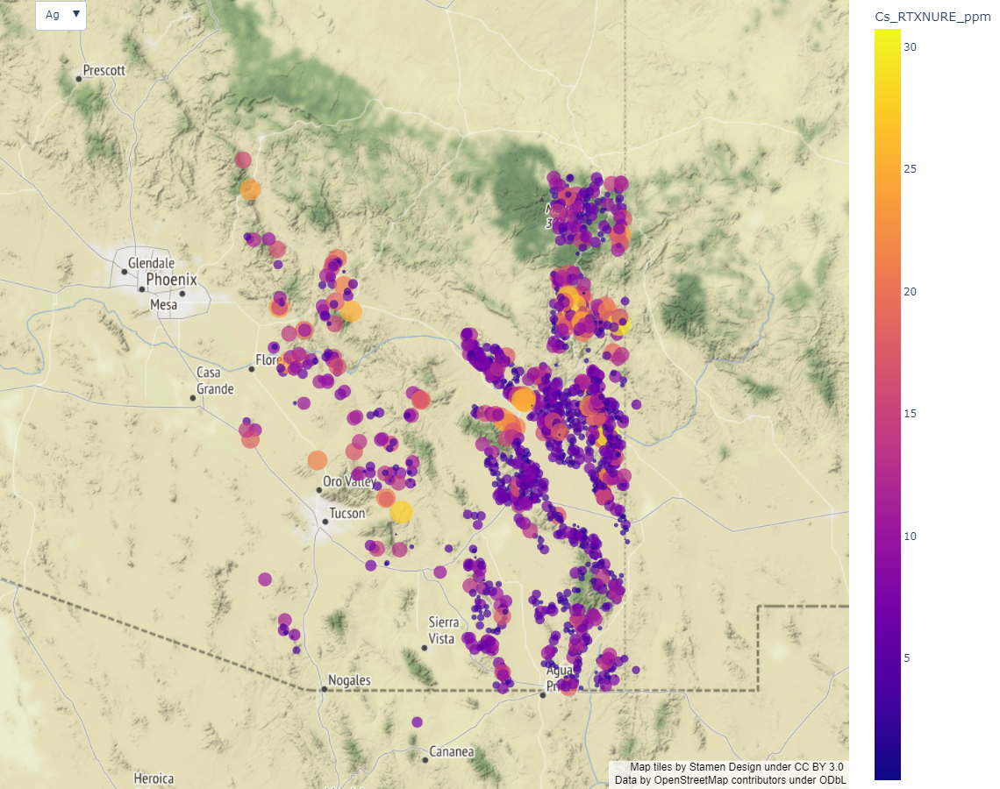

In [40]:
#| fig-cap: 
#|   - "Geopgraphic plot of absolute difference between trace element values and predictions from random forest."
#create_plotly(trace_element_names, trace_element_dict, percentage_diff, center, 0.1, 1.0, 'z')
create_plotly_mapbox(trace_element_names, trace_element_dict, percentage_diff, center, 0.1, 1.0, 10)

UMAP unsupervised clustering has been applied on all trace and major element data using HDBSCAN. The next two figures show the embeddings in 3D space and the clusters plotted on a map. 

In [41]:
reducer = cuml.UMAP(
    n_neighbors=15,
    n_components=3,
    n_epochs=500,
    min_dist=0.25
)
embedding = reducer.fit_transform(labels_df.iloc[:,:-2])

UMAP_labels = HDBSCAN(
    min_samples=10,
    min_cluster_size=50,
).fit_predict(embedding)

labels_df["UMAP_Labels"] = UMAP_labels

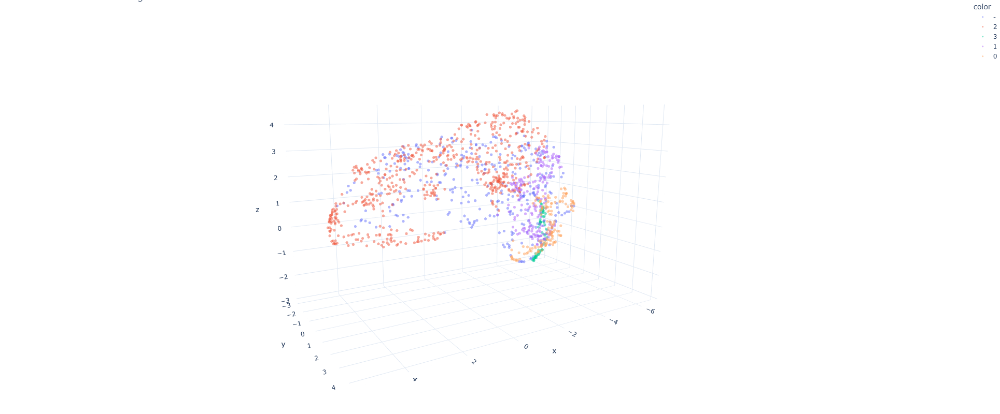

In [42]:
#| fig-cap: 
#|   - "3D scatterplot of UMAP embeddings coloured by HDBSCAN cluster label."
fig = px.scatter_3d(x = embedding[:,0], y = embedding[:,1], z = embedding[:,2], color = np.array(UMAP_labels, dtype='U1'), opacity = 0.5, title = "3D UMAP Embedding")
fig.update_layout(
    width=800,
    height=800,
    autosize=False,
    margin=dict(t=0, b=0, l=0, r=0),
    template="plotly_white",
)
fig.update_traces(marker_size = 3)
fig.show()

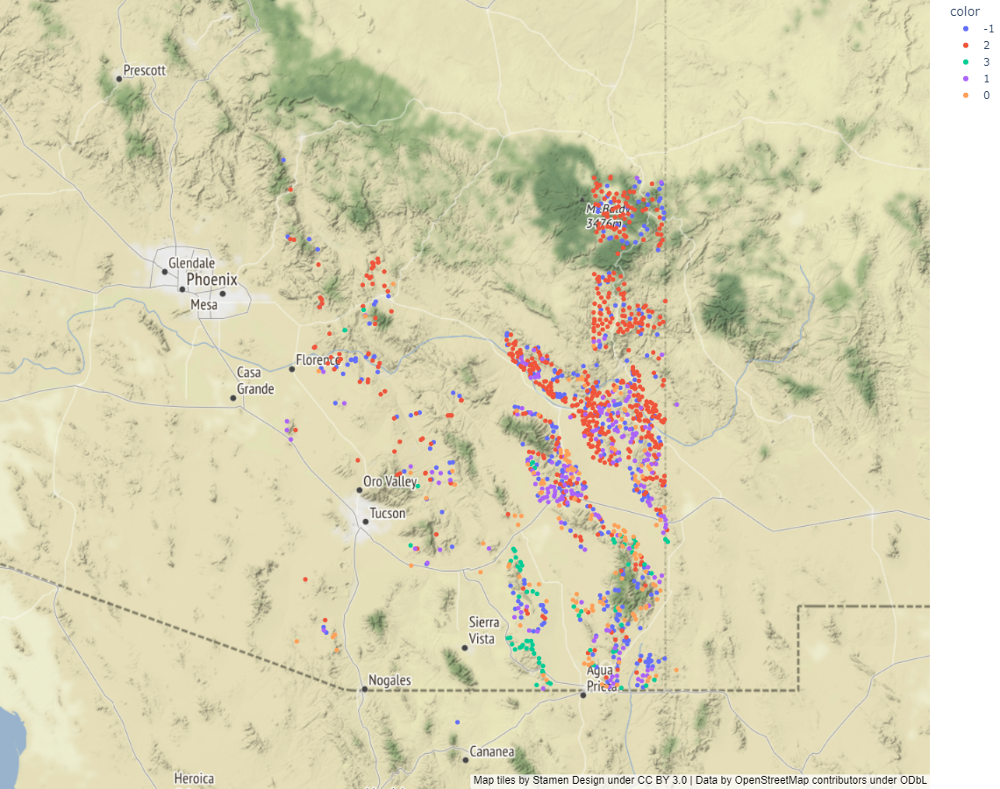

In [43]:
#| fig-cap: 
#|   - "Geographical distribution of UMAP cluster labels."
fig = px.scatter_mapbox(data_frame = labels_df,
                        lat = "WGS84_WORLD_LL_Calc_Y", 
                        lon = "WGS84_WORLD_LL_Calc_X", 
                        color = labels_df["UMAP_Labels"].astype(str),
                        center=dict(lat=center[0], lon=center[1]), 
                        zoom=7,
                        mapbox_style="stamen-terrain"
                        )

fig.update_layout(
    width=800,
    height=900,
    autosize=False,
    margin=dict(t=0, b=0, l=0, r=0),
    template="plotly_white",
)

fig.show()